<a href="https://colab.research.google.com/github/kashishthakur26/Computer-vision-learning/blob/main/Neural_network_for_image_classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## importing the libraries

In [63]:
import cv2
import numpy as np
import os
import zipfile
from google.colab.patches import cv2_imshow
import tensorflow as tf
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
tf.__version__

'2.12.0'

## Extracting pixels from images

In [64]:
zipfile = zipfile.ZipFile('/content/drive/MyDrive/Colab-notebooks/homer_bart_1.zip','r')

zipfile.extractall()
zipfile.close()

In [65]:
directory = '/content/homer_bart_1'

files= [os.path.join(directory ,f) for f in sorted(os.listdir(directory))]
print(files)

['/content/homer_bart_1/.DS_Store', '/content/homer_bart_1/bart1.bmp', '/content/homer_bart_1/bart10.bmp', '/content/homer_bart_1/bart100.bmp', '/content/homer_bart_1/bart101.bmp', '/content/homer_bart_1/bart102.bmp', '/content/homer_bart_1/bart103.bmp', '/content/homer_bart_1/bart104.bmp', '/content/homer_bart_1/bart105.bmp', '/content/homer_bart_1/bart106.bmp', '/content/homer_bart_1/bart108.bmp', '/content/homer_bart_1/bart109.bmp', '/content/homer_bart_1/bart11.bmp', '/content/homer_bart_1/bart110.bmp', '/content/homer_bart_1/bart111.bmp', '/content/homer_bart_1/bart112.bmp', '/content/homer_bart_1/bart113.bmp', '/content/homer_bart_1/bart114.bmp', '/content/homer_bart_1/bart115.bmp', '/content/homer_bart_1/bart116.bmp', '/content/homer_bart_1/bart117.bmp', '/content/homer_bart_1/bart118.bmp', '/content/homer_bart_1/bart119.bmp', '/content/homer_bart_1/bart12.bmp', '/content/homer_bart_1/bart120.bmp', '/content/homer_bart_1/bart121.bmp', '/content/homer_bart_1/bart122.bmp', '/conte

In [66]:
 height ,  width = 128 ,128

In [67]:
images = []
classes = []

In [68]:
# image.shape

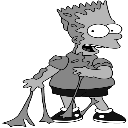

0


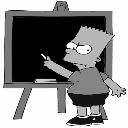

0


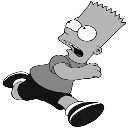

0


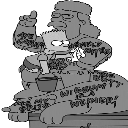

0


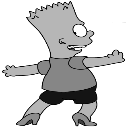

0


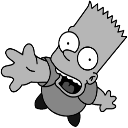

0


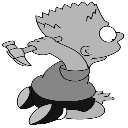

0


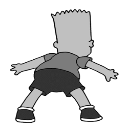

0


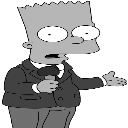

0


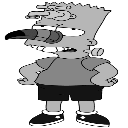

0


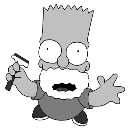

0


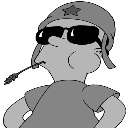

0


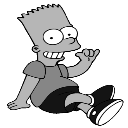

0


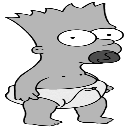

0


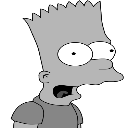

0


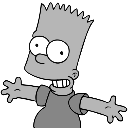

0


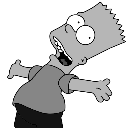

0


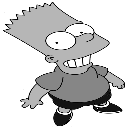

0


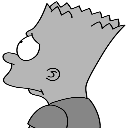

0


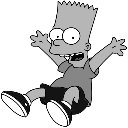

0


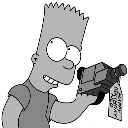

0


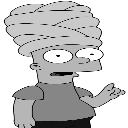

0


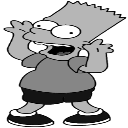

0


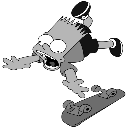

0


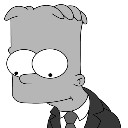

0


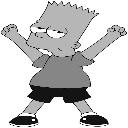

0


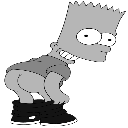

0


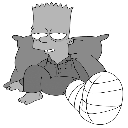

0


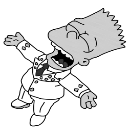

0


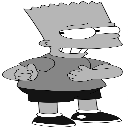

0


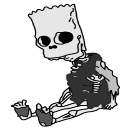

0


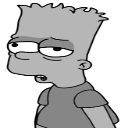

0


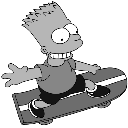

0


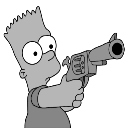

0


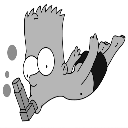

0


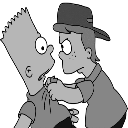

0


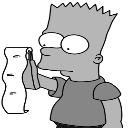

0


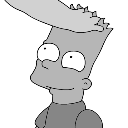

0


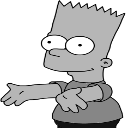

0


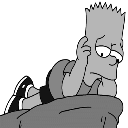

0


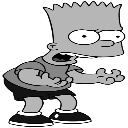

0


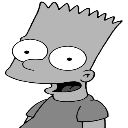

0


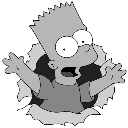

0


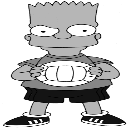

0


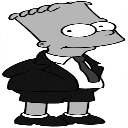

0


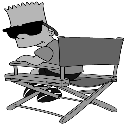

0


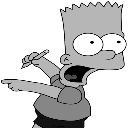

0


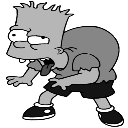

0


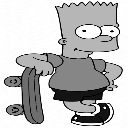

0


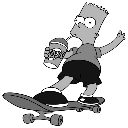

0


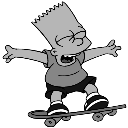

0


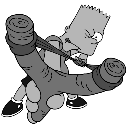

0


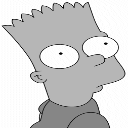

0


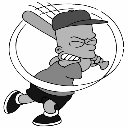

0


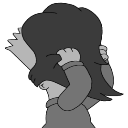

0


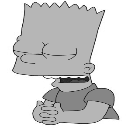

0


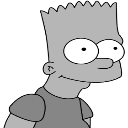

0


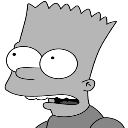

0


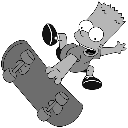

0


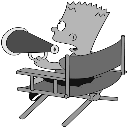

0


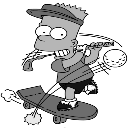

0


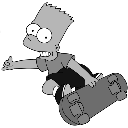

0


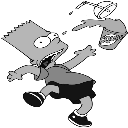

0


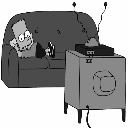

0


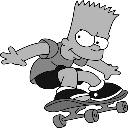

0


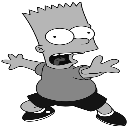

0


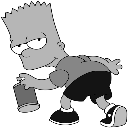

0


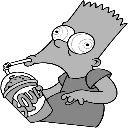

0


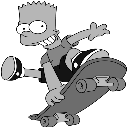

0


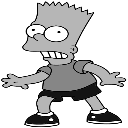

0


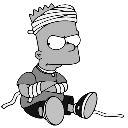

0


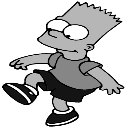

0


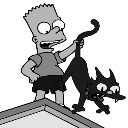

0


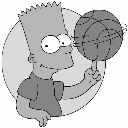

0


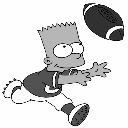

0


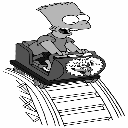

0


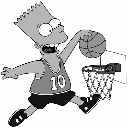

0


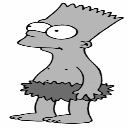

0


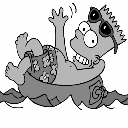

0


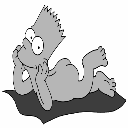

0


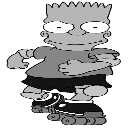

0


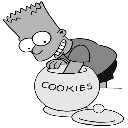

0


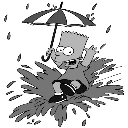

0


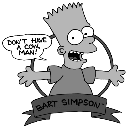

0


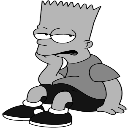

0


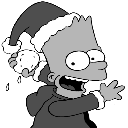

0


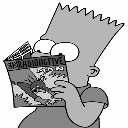

0


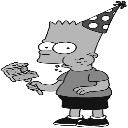

0


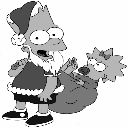

0


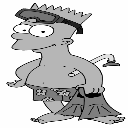

0


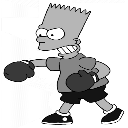

0


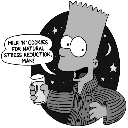

0


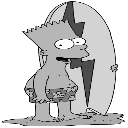

0


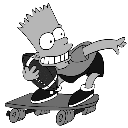

0


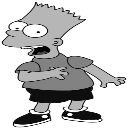

0


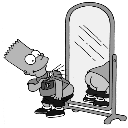

0


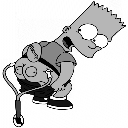

0


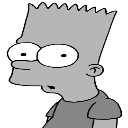

0


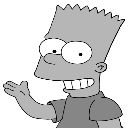

0


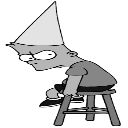

0


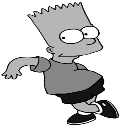

0


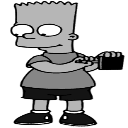

0


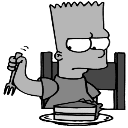

0


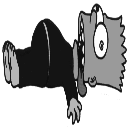

0


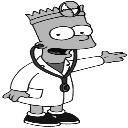

0


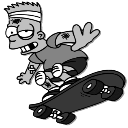

0


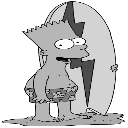

0


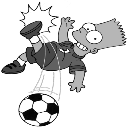

0


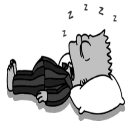

0


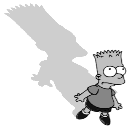

0


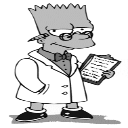

0


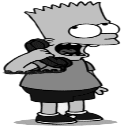

0


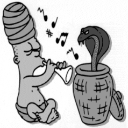

0


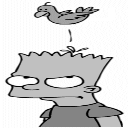

0


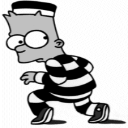

0


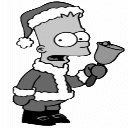

0


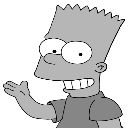

0


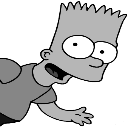

0


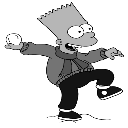

0


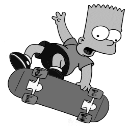

0


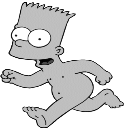

0


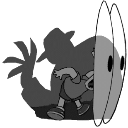

0


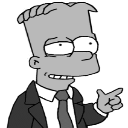

0


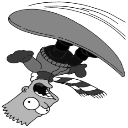

0


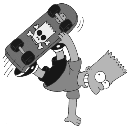

0


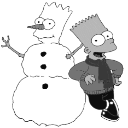

0


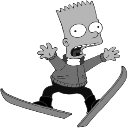

0


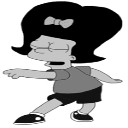

0


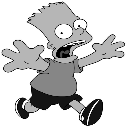

0


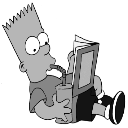

0


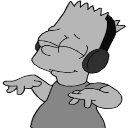

0


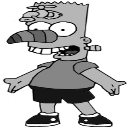

0


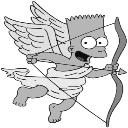

0


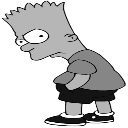

0


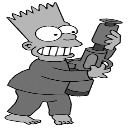

0


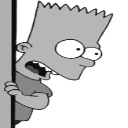

0


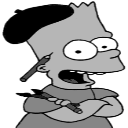

0


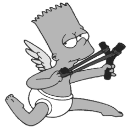

0


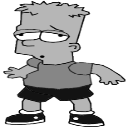

0


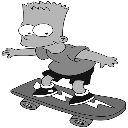

0


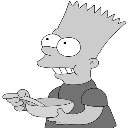

0


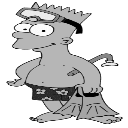

0


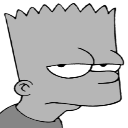

0


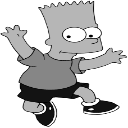

0


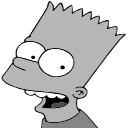

0


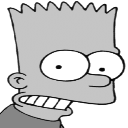

0


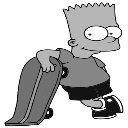

0


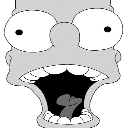

0


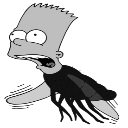

0


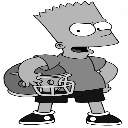

0


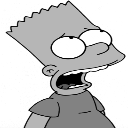

0


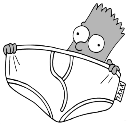

0


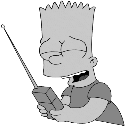

0


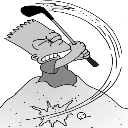

0


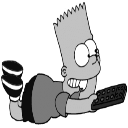

0


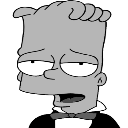

0


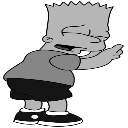

0


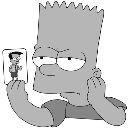

0


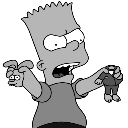

0


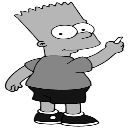

0


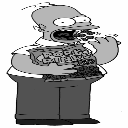

1


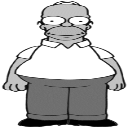

1


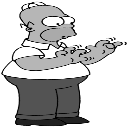

1


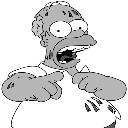

1


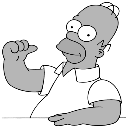

1


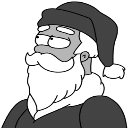

1


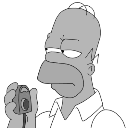

1


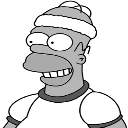

1


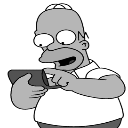

1


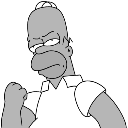

1


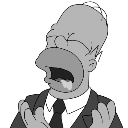

1


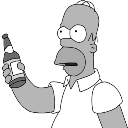

1


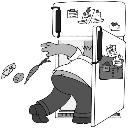

1


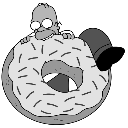

1


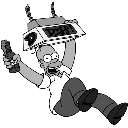

1


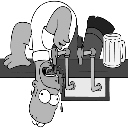

1


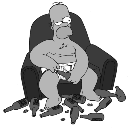

1


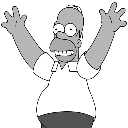

1


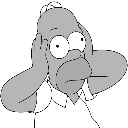

1


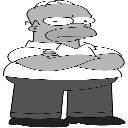

1


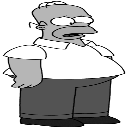

1


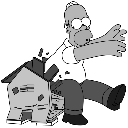

1


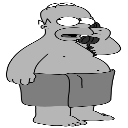

1


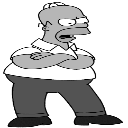

1


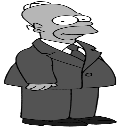

1


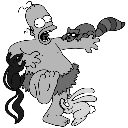

1


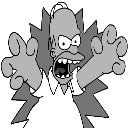

1


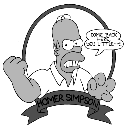

1


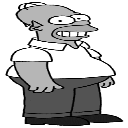

1


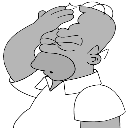

1


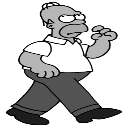

1


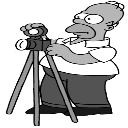

1


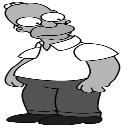

1


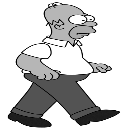

1


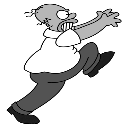

1


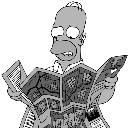

1


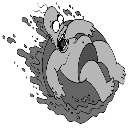

1


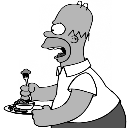

1


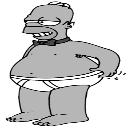

1


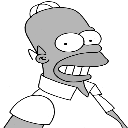

1


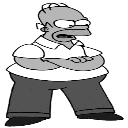

1


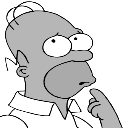

1


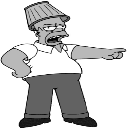

1


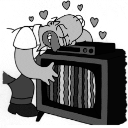

1


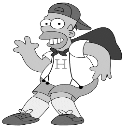

1


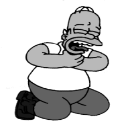

1


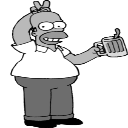

1


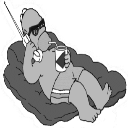

1


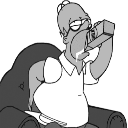

1


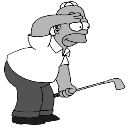

1


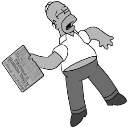

1


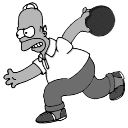

1


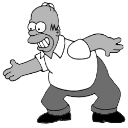

1


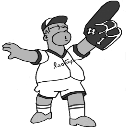

1


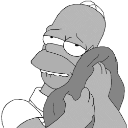

1


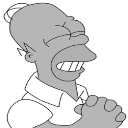

1


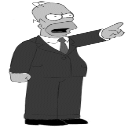

1


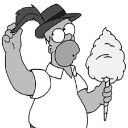

1


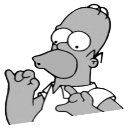

1


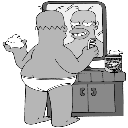

1


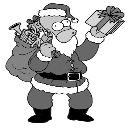

1


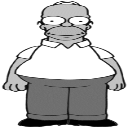

1


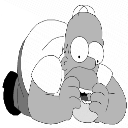

1


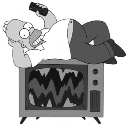

1


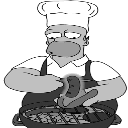

1


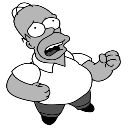

1


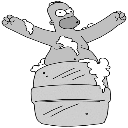

1


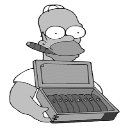

1


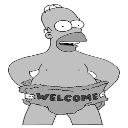

1


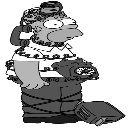

1


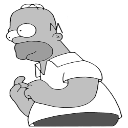

1


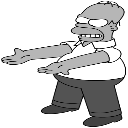

1


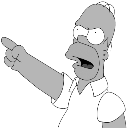

1


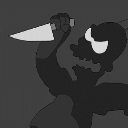

1


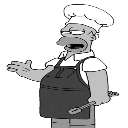

1


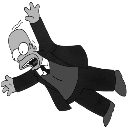

1


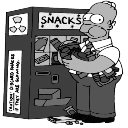

1


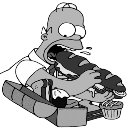

1


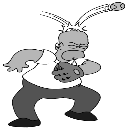

1


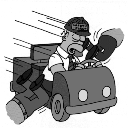

1


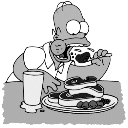

1


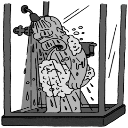

1


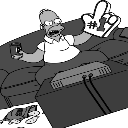

1


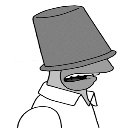

1


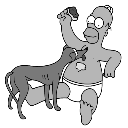

1


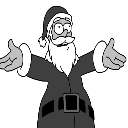

1


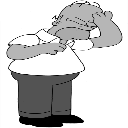

1


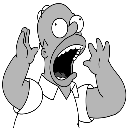

1


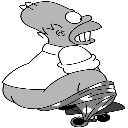

1


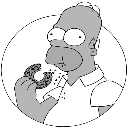

1


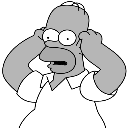

1


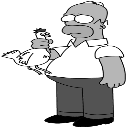

1


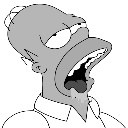

1


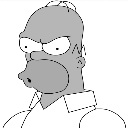

1


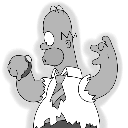

1


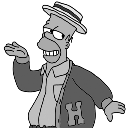

1


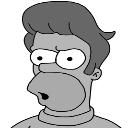

1


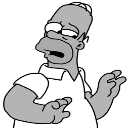

1


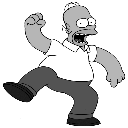

1


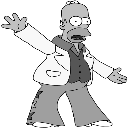

1


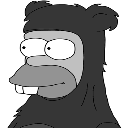

1


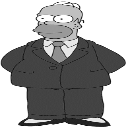

1


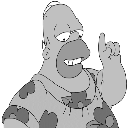

1


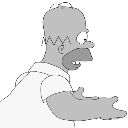

1


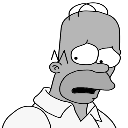

1


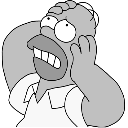

1


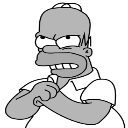

1


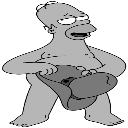

1


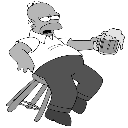

1


In [69]:
for image_path in files:
  try:
    image = cv2.imread(image_path)
    (H,W) = image.shape[:2]

  except:
    continue

  image = cv2.resize(image , (width , height))
  image = cv2.cvtColor(image , cv2.COLOR_BGR2GRAY)

  cv2_imshow(image)

  image = image.ravel()
  # print(image.shape)


  images.append(image)

  image_name = os.path.basename(os.path.normpath(image_path))
  if image_name.startswith('b'):
    class_name = 0
  else:
    class_name = 1

  classes.append(class_name)
  print(class_name)





In [70]:
x = np.asarray(images)
y = np.asarray(classes)

In [71]:
type(x), type(y)

(numpy.ndarray, numpy.ndarray)

In [72]:
x.shape

(269, 16384)

In [73]:
y.shape

(269,)

<Axes: ylabel='count'>

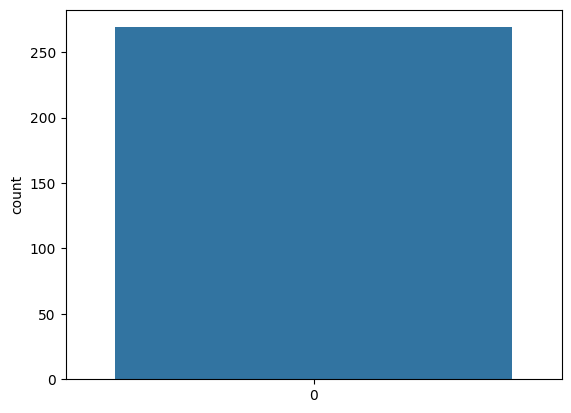

In [74]:
sns.countplot(y)

In [75]:
np.unique(y , return_counts=True)

(array([0, 1]), array([160, 109]))

## Normalizing the data

In [76]:
x[0].max() , x[0].min()

(255, 0)

In [77]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
x = scaler.fit_transform(x)

## Train and test set

In [78]:
from sklearn.model_selection import train_test_split

In [79]:
x_train ,x_test , y_train , y_test = train_test_split(x,y, test_size=0.2 , random_state = 1)

In [80]:
x_train.shape , y_train.shape

((215, 16384), (215,))

## Building ans training neural network

In [81]:
network1 = tf.keras.models.Sequential()
network1.add(tf.keras.layers.Dense(input_shape=(16384,), units=8193 , activation='relu'))
network1.add(tf.keras.layers.Dense(units=8193, activation='relu'))
network1.add(tf.keras.layers.Dense(units=1, activation='sigmoid'))


In [82]:
network1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 8193)              134242305 
                                                                 
 dense_4 (Dense)             (None, 8193)              67133442  
                                                                 
 dense_5 (Dense)             (None, 1)                 8194      
                                                                 
Total params: 201,383,941
Trainable params: 201,383,941
Non-trainable params: 0
_________________________________________________________________


In [83]:
network1.compile(optimizer='Adam',
                 loss='binary_crossentropy',
                 metrics=['accuracy'])

In [84]:
history = network1.fit(x_train , y_train ,epochs=50)

Epoch 1/50
7/7 [==============================] - 3s 56ms/step - loss: 122.7806 - accuracy: 0.5581
Epoch 2/50
7/7 [==============================] - 0s 48ms/step - loss: 8.4345 - accuracy: 0.5070
Epoch 3/50
7/7 [==============================] - 0s 49ms/step - loss: 3.7628 - accuracy: 0.5535
Epoch 4/50
7/7 [==============================] - 0s 47ms/step - loss: 1.3092 - accuracy: 0.5163
Epoch 5/50
7/7 [==============================] - 0s 50ms/step - loss: 0.6838 - accuracy: 0.5953
Epoch 6/50
7/7 [==============================] - 0s 49ms/step - loss: 0.6502 - accuracy: 0.6186
Epoch 7/50
7/7 [==============================] - 0s 50ms/step - loss: 0.6468 - accuracy: 0.6419
Epoch 8/50
7/7 [==============================] - 0s 49ms/step - loss: 0.6466 - accuracy: 0.6512
Epoch 9/50
7/7 [==============================] - 0s 48ms/step - loss: 0.6409 - accuracy: 0.6186
Epoch 10/50
7/7 [==============================] - 0s 50ms/step - loss: 0.6990 - accuracy: 0.5302
Epoch 11/50
7/7 [==========

## Evaluating the NN

In [85]:
history.history.keys()

dict_keys(['loss', 'accuracy'])

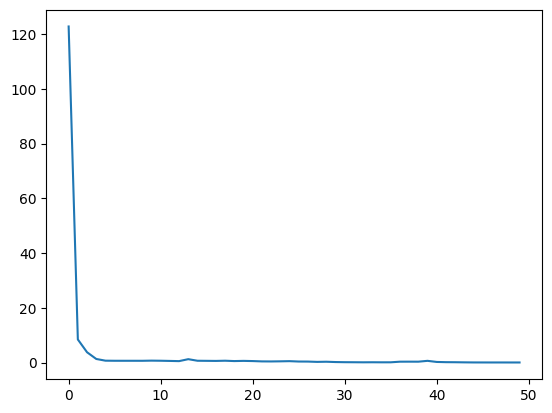

In [86]:
plt.plot(history.history['loss'])

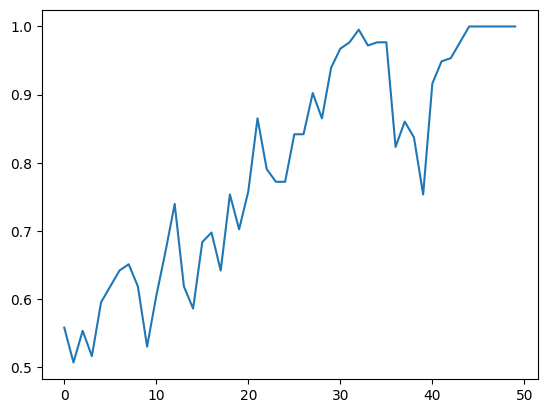

In [87]:
plt.plot(history.history['accuracy'])

In [88]:
predictions = network1.predict(x_test)

2/2 [==============================] - 0s 8ms/step


In [89]:
predictions = (predictions > 0.5)

In [90]:
predictions

array([[False],
       [ True],
       [False],
       [False],
       [ True],
       [False],
       [ True],
       [ True],
       [False],
       [ True],
       [False],
       [ True],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [False],
       [False],
       [False],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [False],
       [ True],
       [ True],
       [False],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [False],
       [False],
       [ True],
       [False],
       [ True],
       [ True],
       [False]])

In [91]:
from sklearn.metrics import accuracy_score , confusion_matrix
accuracy_score(y_test, predictions)

0.7222222222222222

In [92]:
cm = confusion_matrix(y_test , predictions)
cm

array([[24,  4],
       [11, 15]])

<Axes: >

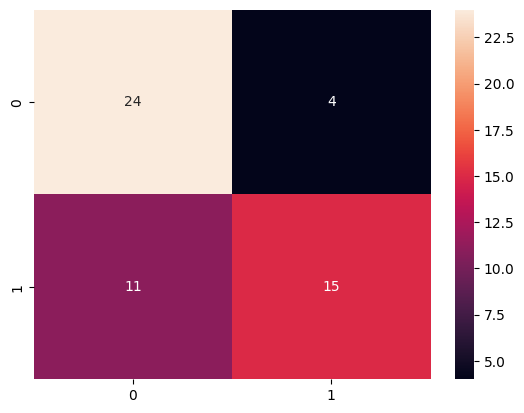

In [93]:
sns.heatmap(cm , annot=True)

In [94]:
from sklearn.metrics import classification_report

In [95]:
print(classification_report(predictions, y_test))


              precision    recall  f1-score   support

       False       0.86      0.69      0.76        35
        True       0.58      0.79      0.67        19

    accuracy                           0.72        54
   macro avg       0.72      0.74      0.71        54
weighted avg       0.76      0.72      0.73        54



## saving and loading the netrwork

In [96]:
model_json = network1.to_json()
with open('network1.json','w') as json_file:
  json_file.write(model_json)


In [97]:
from keras.models import save_model
network1_saved = save_model(network1 ,'wieghts1.hdf5')

In [98]:
with open('network1.json') as json_file:
  json_saved_model = json_file.read()

json_saved_model

'{"class_name": "Sequential", "config": {"name": "sequential_1", "layers": [{"class_name": "InputLayer", "config": {"batch_input_shape": [null, 16384], "dtype": "float32", "sparse": false, "ragged": false, "name": "dense_3_input"}}, {"class_name": "Dense", "config": {"name": "dense_3", "trainable": true, "dtype": "float32", "batch_input_shape": [null, 16384], "units": 8193, "activation": "relu", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regularizer": null, "bias_regularizer": null, "activity_regularizer": null, "kernel_constraint": null, "bias_constraint": null}}, {"class_name": "Dense", "config": {"name": "dense_4", "trainable": true, "dtype": "float32", "units": 8193, "activation": "relu", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regulariz

In [99]:
network1_loaded = tf.keras.models.model_from_json(json_saved_model)
network1_loaded.load_weights('/content/wieghts1.hdf5')
network1_loaded.compile(loss = 'binary_crossentropy' , optimizer= 'Adam')

In [100]:
network1.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_3 (Dense)             (None, 8193)              134242305 
                                                                 
 dense_4 (Dense)             (None, 8193)              67133442  
                                                                 
 dense_5 (Dense)             (None, 1)                 8194      
                                                                 
Total params: 201,383,941
Trainable params: 201,383,941
Non-trainable params: 0
_________________________________________________________________


## Classifying one single image

In [101]:
x_test[0].shape

(16384,)

In [102]:
test_image = x_test[46]
test_image = scaler.inverse_transform(test_image.reshape(1,-1))

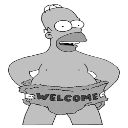

In [103]:
cv2_imshow(test_image.reshape(width , height))

In [104]:
network1_loaded.predict(test_image)[0][0]

1/1 [==============================] - 0s 103ms/step


1.0

In [105]:
if network1_loaded.predict(test_image)[0][0] < 0.5:
  print('Bart')
else:
  print('Homer')

1/1 [==============================] - 0s 39ms/step
Homer


## feature extraction with opencv(Image classifcation)

In [106]:
export = 'mouth,pants,shoes,tshirt,shorts,sneakers,class\n'

In [107]:
show_images = True
features = []

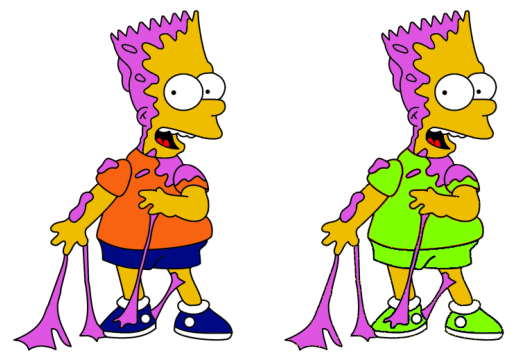

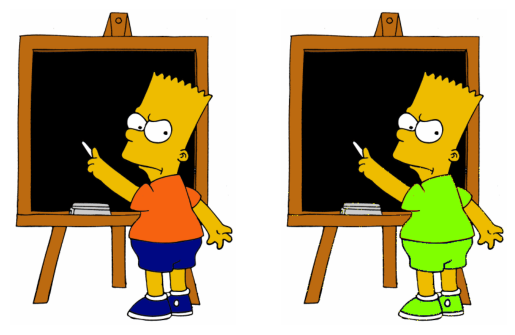

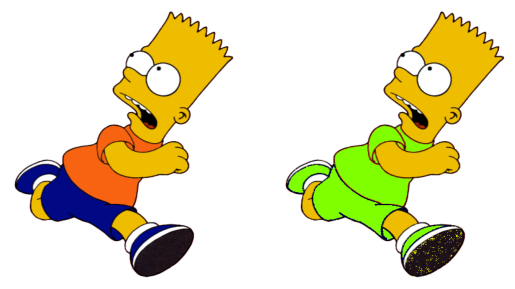

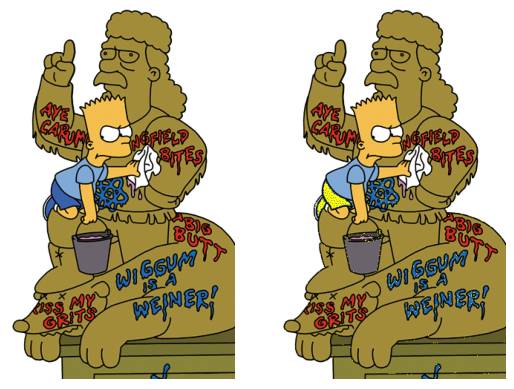

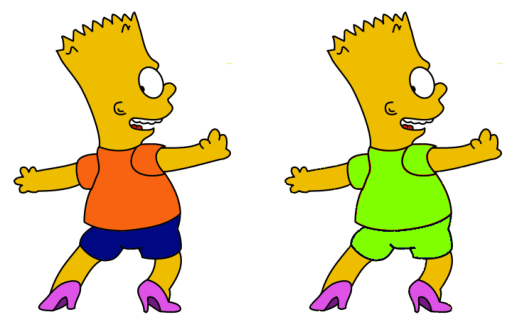

...

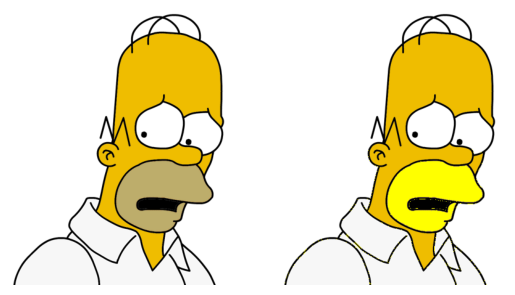

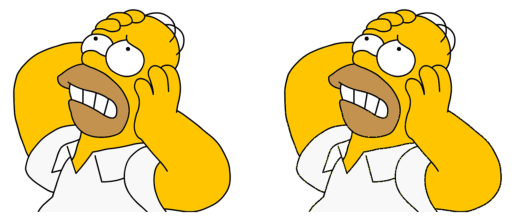

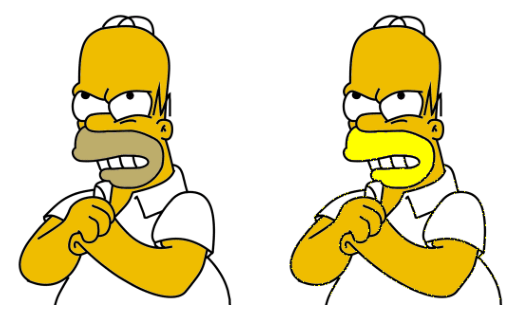

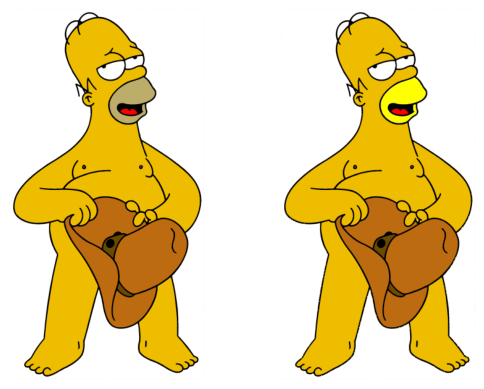

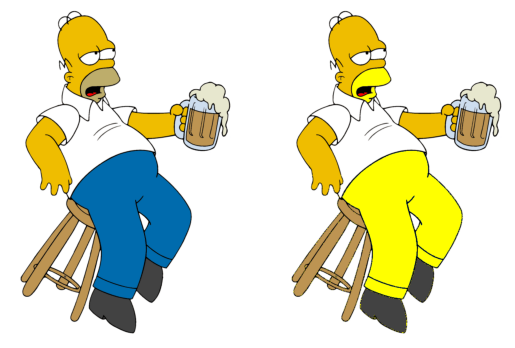

In [108]:
for image_path in files:
  #print(image_path)
  try:
    original_image = cv2.imread(image_path)
    (H, W) = original_image.shape[:2]
  except:
    continue

  image = original_image.copy()
  image_features = []
  mouth = pants = shoes = 0
  tshirt = shorts = sneakers = 0

  image_name = os.path.basename(os.path.normpath(image_path))

  if image_name.startswith('b'):
    class_name = 0
  else:
    class_name = 1

  for height in range(0, H):
    for width in range(0, W):
      blue = image.item(height, width, 0)
      green = image.item(height, width, 1)
      red = image.item(height, width, 2)

      # Homer - brown mouth
      if (blue >= 95 and blue <= 140 and green >= 160 and green <= 185 and red >= 175 and red <= 200):
        image[height, width] = [0, 255, 255]
        mouth += 1

      # Homer - blue pants
      if (blue >= 150 and blue <= 180 and green >= 98 and green <= 120 and red >= 0 and red <= 90):
        image[height, width] = [0, 255, 255]
        pants += 1

      # Homer - gray shoes
      if height > (H / 2):
        if (blue >= 25 and blue <= 45 and green >= 25 and green <= 45 and red >= 25 and red <= 45):
          image[height, width] = [0, 255, 255]
          shoes += 1

      # Bart - orange t-shirt
      if (blue >= 11 and blue <= 22 and green >= 85 and green <= 105 and red >= 240 and red <= 255):
        image[height, width] = [0, 255, 128]
        tshirt += 1

      # Bart - blue shorts
      if (blue >= 125 and blue <= 170 and green >= 0 and green <= 12 and red >= 0 and red <= 20):
        image[height, width] = [0, 255, 128]
        shorts += 1

      # Bart - blue sneakers
      if height > (H / 2):
        if (blue >= 125 and blue <= 170 and green >= 0 and green <= 12 and red >= 0 and red <= 20):
          image[height, width] = [0, 255, 128]
          sneakers += 1

  mouth = round((mouth / (H * W)) * 100, 9)
  pants = round((pants / (H * W)) * 100, 9)
  shoes = round((shoes / (H * W)) * 100, 9)

  tshirt = round((tshirt / (H * W)) * 100, 9)
  shorts = round((shorts / (H * W)) * 100, 9)
  sneakers = round((sneakers / (H * W)) * 100, 9)

  image_features.append(mouth)
  image_features.append(pants)
  image_features.append(shoes)
  image_features.append(tshirt)
  image_features.append(shorts)
  image_features.append(sneakers)
  image_features.append(class_name)

  features.append(image_features)

  #print('Homer mouth: %s - Homer pants: %s - Homer shoes: %s' % (image_features[0], image_features[1], image_features[2]))
  #print('Bart t-shirt: %s - Bart shorts: %s - Bart sneakers: %s' % (image_features[3], image_features[4], image_features[5]))

  f = (",".join([str(item) for item in image_features]))
  export += f + '\n'

  if show_images == True:
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    fig, im = plt.subplots(1, 2)
    im[0].axis('off')
    im[0].imshow(original_image)
    im[1].axis('off')
    im[1].imshow(image)
    plt.show()

In [109]:
export

'mouth,pants,shoes,tshirt,shorts,sneakers,class\n0.0,0.0,0.114799225,6.886101887,3.495204355,3.495204355,0\n0.0,0.0,0.11007847,5.004901113,3.183888705,3.183888705,0\n0.0,0.0,0.182518631,5.264620437,5.029682961,5.029682961,0\n0.0,0.480168257,0.080028043,0.0,0.0,0.0,0\n0.0,0.0,0.029707562,8.978929368,3.459119497,3.459119497,0\n0.0,0.0,0.053304904,6.75432362,0.948827292,0.948827292,0\n0.249585206,0.0,0.019853369,9.693407263,4.104683977,4.104683977,0\n0.0,0.0,0.181208054,0.0,0.0,0.0,0\n0.0,0.0,0.148868778,0.0,0.0,0.0,0\n0.0,0.0,0.114762211,9.594752524,7.522715548,7.522715548,0\n0.0,0.0,0.138655462,0.0,0.0,0.0,0\n0.0,0.0,0.02400947,19.545383481,0.0,0.0,0\n0.00307645,0.0,0.0,6.495154592,5.599138594,5.599138594,0\n0.001317263,0.0,0.087817515,0.0,0.0,0.0,0\n0.0,0.0,0.032184591,8.395721925,0.0,0.0,0\n0.02105732,0.0,0.008503918,8.915750471,0.0,0.0,0\n0.0,0.0,0.081055114,11.095816228,4.525111363,4.525111363,0\n0.0,0.0,0.08757526,10.443349754,3.183296307,3.183296307,0\n0.0,0.0,0.043806812,9.497408

In [110]:
with open('features.csv', 'w') as file:
  for l in export:
    file.write(l)
file.closed

True

In [111]:
dataset = pd.read_csv('features.csv')
dataset

,mouth,pants,shoes,tshirt,shorts,sneakers,class
0,0.000000,0.000000,0.114799,6.886102,3.495204,3.495204,0
1,0.000000,0.000000,0.110078,5.004901,3.183889,3.183889,0
2,0.000000,0.000000,0.182519,5.264620,5.029683,5.029683,0
3,0.000000,0.480168,0.080028,0.000000,0.000000,0.000000,0
4,0.000000,0.000000,0.029708,8.978929,3.459119,3.459119,0
...,...,...,...,...,...,...,...
264,6.485412,0.000000,0.171985,0.000000,0.000000,0.000000,1
265,0.000000,0.000000,0.161637,0.000000,0.000000,0.000000,1
266,4.264975,0.000000,0.329940,0.000000,0.000000,0.000000,1
267,1.429133,0.000000,0.034559,0.000000,0.000000,0.000000,1


## Train and tests sets

In [113]:
x = dataset.iloc[:, 0:6].values
x

array([[ 0.        ,  0.        ,  0.11479923,  6.88610189,  3.49520435,
         3.49520435],
       [ 0.        ,  0.        ,  0.11007847,  5.00490111,  3.18388871,
         3.18388871],
       [ 0.        ,  0.        ,  0.18251863,  5.26462044,  5.02968296,
         5.02968296],
       ...,
       [ 4.26497522,  0.        ,  0.32993967,  0.        ,  0.        ,
         0.        ],
       [ 1.42913348,  0.        ,  0.03455866,  0.        ,  0.        ,
         0.        ],
       [ 0.853902  , 13.74424774,  0.16177802,  0.        ,  0.        ,
         0.        ]])

In [114]:
y = dataset.iloc[:, 6].values
y

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1])

In [117]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(x, y, test_size = 0.2, random_state = 1)

In [118]:
X_train.shape, y_train.shape

((215, 6), (215,))

In [119]:
X_test.shape, y_test.shape

((54, 6), (54,))

## Building and training the neural network

In [120]:
network2 = tf.keras.models.Sequential()
network2.add(tf.keras.layers.Dense(input_shape = (6,), units = 4, activation='relu'))
network2.add(tf.keras.layers.Dense(units = 4, activation='relu'))
network2.add(tf.keras.layers.Dense(units = 4, activation='relu'))
network2.add(tf.keras.layers.Dense(units = 1, activation='sigmoid'))

In [121]:
network2.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 4)                 28        
                                                                 
 dense_7 (Dense)             (None, 4)                 20        
                                                                 
 dense_8 (Dense)             (None, 4)                 20        
                                                                 
 dense_9 (Dense)             (None, 1)                 5         
                                                                 
Total params: 73
Trainable params: 73
Non-trainable params: 0
_________________________________________________________________


In [122]:
network2.compile(optimizer='Adam', loss='binary_crossentropy', metrics = ['accuracy'])

In [123]:
history = network2.fit(X_train, y_train, epochs = 50)

Epoch 1/50
7/7 [==============================] - 6s 11ms/step - loss: 0.6895 - accuracy: 0.8279
Epoch 2/50
7/7 [==============================] - 0s 13ms/step - loss: 0.6789 - accuracy: 0.8651
Epoch 3/50
7/7 [==============================] - 0s 14ms/step - loss: 0.6734 - accuracy: 0.8698
Epoch 4/50
7/7 [==============================] - 0s 12ms/step - loss: 0.6681 - accuracy: 0.8651
Epoch 5/50
7/7 [==============================] - 0s 13ms/step - loss: 0.6639 - accuracy: 0.8558
Epoch 6/50
7/7 [==============================] - 0s 13ms/step - loss: 0.6595 - accuracy: 0.8558
Epoch 7/50
7/7 [==============================] - 0s 21ms/step - loss: 0.6543 - accuracy: 0.8558
Epoch 8/50
7/7 [==============================] - 0s 19ms/step - loss: 0.6481 - accuracy: 0.8558
Epoch 9/50
7/7 [==============================] - 0s 22ms/step - loss: 0.6420 - accuracy: 0.8558
Epoch 10/50
7/7 [==============================] - 0s 10ms/step - loss: 0.6355 - accuracy: 0.8558
Epoch 11/50
7/7 [============

## Evaluating neural network

In [124]:
predictions = network2.predict(X_test)
predictions

2/2 [==============================] - 0s 7ms/step


array([[0.02825261],
       [0.9649617 ],
       [0.16673015],
       [0.43042496],
       [0.15473396],
       [0.98026353],
       [0.00984405],
       [0.19313411],
       [0.11365229],
       [0.13107426],
       [0.21718934],
       [0.9998318 ],
       [0.7368588 ],
       [0.03507433],
       [0.43084326],
       [0.9997434 ],
       [0.5847941 ],
       [0.9898712 ],
       [0.41531464],
       [0.12176135],
       [0.00160285],
       [0.9961844 ],
       [0.9395373 ],
       [0.06803951],
       [0.01543656],
       [0.9989826 ],
       [0.44448194],
       [0.10958499],
       [0.9590508 ],
       [0.9999156 ],
       [0.9260279 ],
       [0.9999993 ],
       [0.99959284],
       [0.46175227],
       [0.9999938 ],
       [0.9303124 ],
       [0.12431826],
       [0.12037756],
       [0.4306563 ],
       [0.17568906],
       [0.9352629 ],
       [0.436224  ],
       [0.07771419],
       [0.0657703 ],
       [0.04880797],
       [0.99837637],
       [0.70882666],
       [0.429

In [125]:
predictions = (predictions > 0.5)
predictions

array([[False],
       [ True],
       [False],
       [False],
       [False],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [ True],
       [False],
       [False],
       [ True],
       [ True],
       [ True],
       [False],
       [False],
       [False],
       [ True],
       [ True],
       [False],
       [False],
       [ True],
       [False],
       [False],
       [ True],
       [ True],
       [ True],
       [ True],
       [ True],
       [False],
       [ True],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [False],
       [False],
       [False],
       [False],
       [ True],
       [ True],
       [False],
       [False],
       [ True],
       [False],
       [ True],
       [ True],
       [ True]])

In [126]:
y_test

array([0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1,
       0, 0, 0, 1, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0,
       0, 1, 1, 0, 0, 1, 0, 1, 1, 1])

In [127]:
from sklearn.metrics import accuracy_score
accuracy_score(y_test, predictions) # 0.68

0.9259259259259259

In [128]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(y_test, predictions)
cm

array([[27,  1],
       [ 3, 23]])

In [129]:
from sklearn.metrics import classification_report
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.90      0.96      0.93        28
           1       0.96      0.88      0.92        26

    accuracy                           0.93        54
   macro avg       0.93      0.92      0.93        54
weighted avg       0.93      0.93      0.93        54



## Saving loading an d classifying one single one single image

In [130]:
model_json = network2.to_json()
with open('network2.json','w') as json_file:
  json_file.write(model_json)

In [131]:
from keras.models import save_model
network2_saved = save_model(network2, '/content/weights2.hdf5')

In [132]:
with open('network2.json', 'r') as json_file:
  json_saved_model = json_file.read()
json_saved_model

'{"class_name": "Sequential", "config": {"name": "sequential_2", "layers": [{"class_name": "InputLayer", "config": {"batch_input_shape": [null, 6], "dtype": "float32", "sparse": false, "ragged": false, "name": "dense_6_input"}}, {"class_name": "Dense", "config": {"name": "dense_6", "trainable": true, "dtype": "float32", "batch_input_shape": [null, 6], "units": 4, "activation": "relu", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regularizer": null, "bias_regularizer": null, "activity_regularizer": null, "kernel_constraint": null, "bias_constraint": null}}, {"class_name": "Dense", "config": {"name": "dense_7", "trainable": true, "dtype": "float32", "units": 4, "activation": "relu", "use_bias": true, "kernel_initializer": {"class_name": "GlorotUniform", "config": {"seed": null}}, "bias_initializer": {"class_name": "Zeros", "config": {}}, "kernel_regularizer": null, "bi

In [133]:
network2_loaded = tf.keras.models.model_from_json(json_saved_model)
network2_loaded.load_weights('weights2.hdf5')
network2_loaded.compile(loss = 'binary_crossentropy', optimizer='Adam', metrics=['accuracy'])

In [134]:
test_image = X_test[0]
test_image

array([3.07645000e-03, 0.00000000e+00, 0.00000000e+00, 6.49515459e+00,
       5.59913859e+00, 5.59913859e+00])

In [137]:
test_image = test_image.reshape(1,-1)
test_image.shape
network2_loaded.predict(test_image)[0][0]



1/1 [==============================] - 0s 80ms/step


0.0282526

In [138]:
if network2_loaded.predict(test_image)[0][0] < 0.5:
  print('Bart')
else:
  print('Homer')

1/1 [==============================] - 0s 43ms/step
Bart
